In [1]:
# Importing the proper packages to prepare my data for analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ast import literal_eval 
from collections import Counter
sns.set_theme(style="darkgrid")
%matplotlib inline
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler,PolynomialFeatures
from sklearn.linear_model import LinearRegression
sns.set()
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.formula.api import ols
import statsmodels.api as sm
import scipy.stats as stats
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import r2_score, mean_squared_error

In [2]:
flood_df = pd.read_csv('/Users/jdapeman/Documents/Flatiron/Kings_C_PROJECT/cleaned_flood_data.csv')
house_df = pd.read_csv("/Users/jdapeman/Documents/Flatiron/Kings_C_PROJECT/kc_house_data.csv")
new_df = pd.read_csv("/Users/jdapeman/Documents/Flatiron/Kings_C_PROJECT/cleaned_housing_data.csv")

In [3]:
house_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sewer_system,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_built,yr_renovated,address,lat,long
0,7399300360,5/24/2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,PUBLIC,1180,0,0,40,1969,0,"2102 Southeast 21st Court, Renton, Washington ...",47.461975,-122.19052
1,8910500230,12/13/2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,PUBLIC,1570,1570,0,240,1950,0,"11231 Greenwood Avenue North, Seattle, Washing...",47.711525,-122.35591
2,1180000275,9/29/2021,311000.0,6,2.0,2880,6156,1.0,NO,NO,...,PUBLIC,1580,1580,0,0,1956,0,"8504 South 113th Street, Seattle, Washington 9...",47.502045,-122.22520
3,1604601802,12/14/2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,PUBLIC,1090,1070,200,270,2010,0,"4079 Letitia Avenue South, Seattle, Washington...",47.566110,-122.29020
4,8562780790,8/24/2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,PUBLIC,1120,550,550,30,2012,0,"2193 Northwest Talus Drive, Issaquah, Washingt...",47.532470,-122.07188


In [4]:
type(house_df["address"])

pandas.core.series.Series

In [5]:
house_df["address"] = house_df['address'].str.split(',')

In [6]:
house_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sewer_system,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_built,yr_renovated,address,lat,long
0,7399300360,5/24/2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,PUBLIC,1180,0,0,40,1969,0,"[2102 Southeast 21st Court, Renton, Washingt...",47.461975,-122.19052
1,8910500230,12/13/2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,PUBLIC,1570,1570,0,240,1950,0,"[11231 Greenwood Avenue North, Seattle, Wash...",47.711525,-122.35591
2,1180000275,9/29/2021,311000.0,6,2.0,2880,6156,1.0,NO,NO,...,PUBLIC,1580,1580,0,0,1956,0,"[8504 South 113th Street, Seattle, Washingto...",47.502045,-122.22520
3,1604601802,12/14/2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,PUBLIC,1090,1070,200,270,2010,0,"[4079 Letitia Avenue South, Seattle, Washing...",47.566110,-122.29020
4,8562780790,8/24/2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,PUBLIC,1120,550,550,30,2012,0,"[2193 Northwest Talus Drive, Issaquah, Washi...",47.532470,-122.07188


In [7]:
house_df['address'][:][2]

['8504 South 113th Street', ' Seattle', ' Washington 98178', ' United States']

In [8]:
house_df['address'] = house_df['address'].apply(lambda x: x[1:])

In [9]:
house_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sewer_system,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_built,yr_renovated,address,lat,long
0,7399300360,5/24/2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,PUBLIC,1180,0,0,40,1969,0,"[ Renton, Washington 98055, United States]",47.461975,-122.19052
1,8910500230,12/13/2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,PUBLIC,1570,1570,0,240,1950,0,"[ Seattle, Washington 98133, United States]",47.711525,-122.35591
2,1180000275,9/29/2021,311000.0,6,2.0,2880,6156,1.0,NO,NO,...,PUBLIC,1580,1580,0,0,1956,0,"[ Seattle, Washington 98178, United States]",47.502045,-122.22520
3,1604601802,12/14/2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,PUBLIC,1090,1070,200,270,2010,0,"[ Seattle, Washington 98118, United States]",47.566110,-122.29020
4,8562780790,8/24/2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,PUBLIC,1120,550,550,30,2012,0,"[ Issaquah, Washington 98027, United States]",47.532470,-122.07188


In [10]:
house_df['address']

0          [ Renton,  Washington 98055,  United States]
1         [ Seattle,  Washington 98133,  United States]
2         [ Seattle,  Washington 98178,  United States]
3         [ Seattle,  Washington 98118,  United States]
4        [ Issaquah,  Washington 98027,  United States]
                              ...                      
30150     [ Seattle,  Washington 98103,  United States]
30151     [ Seattle,  Washington 98116,  United States]
30152     [ Seattle,  Washington 98122,  United States]
30153      [ Renton,  Washington 98055,  United States]
30154      [ Burien,  Washington 98148,  United States]
Name: address, Length: 30155, dtype: object

In [11]:
house_df['address'] = house_df['address'].apply(lambda x: x[1:])

In [12]:
house_df['address']

0        [ Washington 98055,  United States]
1        [ Washington 98133,  United States]
2        [ Washington 98178,  United States]
3        [ Washington 98118,  United States]
4        [ Washington 98027,  United States]
                        ...                 
30150    [ Washington 98103,  United States]
30151    [ Washington 98116,  United States]
30152    [ Washington 98122,  United States]
30153    [ Washington 98055,  United States]
30154    [ Washington 98148,  United States]
Name: address, Length: 30155, dtype: object

In [13]:
house_df['address'] = house_df['address'].apply(lambda x: x[:1] + x[2:] if len(x) > 1 else x)

In [14]:
house_df['address']

0        [ Washington 98055]
1        [ Washington 98133]
2        [ Washington 98178]
3        [ Washington 98118]
4        [ Washington 98027]
                ...         
30150    [ Washington 98103]
30151    [ Washington 98116]
30152    [ Washington 98122]
30153    [ Washington 98055]
30154    [ Washington 98148]
Name: address, Length: 30155, dtype: object

In [15]:
house_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sewer_system,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_built,yr_renovated,address,lat,long
0,7399300360,5/24/2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,PUBLIC,1180,0,0,40,1969,0,[ Washington 98055],47.461975,-122.19052
1,8910500230,12/13/2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,PUBLIC,1570,1570,0,240,1950,0,[ Washington 98133],47.711525,-122.35591
2,1180000275,9/29/2021,311000.0,6,2.0,2880,6156,1.0,NO,NO,...,PUBLIC,1580,1580,0,0,1956,0,[ Washington 98178],47.502045,-122.22520
3,1604601802,12/14/2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,PUBLIC,1090,1070,200,270,2010,0,[ Washington 98118],47.566110,-122.29020
4,8562780790,8/24/2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,PUBLIC,1120,550,550,30,2012,0,[ Washington 98027],47.532470,-122.07188


In [16]:
house_df['address'][3]

[' Washington 98118']

In [17]:
house_df['address'] = house_df['address'].apply(lambda x: [word.strip() for word in ' '.join(x).split(',')])


In [18]:
house_df['address']

0        [Washington 98055]
1        [Washington 98133]
2        [Washington 98178]
3        [Washington 98118]
4        [Washington 98027]
                ...        
30150    [Washington 98103]
30151    [Washington 98116]
30152    [Washington 98122]
30153    [Washington 98055]
30154    [Washington 98148]
Name: address, Length: 30155, dtype: object

In [19]:
flood_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93 entries, 0 to 92
Data columns (total 5 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   zipcode                93 non-null     int64  
 1   floodzones in zipcode  93 non-null     object 
 2   area flood score 1     93 non-null     float64
 3   area flood score 2     93 non-null     float64
 4   avg area flood score   93 non-null     float64
dtypes: float64(3), int64(1), object(1)
memory usage: 3.8+ KB


In [20]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29241 entries, 0 to 29240
Data columns (total 27 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              29241 non-null  int64  
 1   date            29241 non-null  object 
 2   price           29241 non-null  float64
 3   bedrooms        29241 non-null  int64  
 4   bathrooms       29241 non-null  float64
 5   sqft_living     29241 non-null  int64  
 6   sqft_lot        29241 non-null  int64  
 7   floors          29241 non-null  float64
 8   waterfront      29241 non-null  object 
 9   greenbelt       29241 non-null  object 
 10  nuisance        29241 non-null  object 
 11  view            29241 non-null  object 
 12  condition       29241 non-null  object 
 13  grade           29241 non-null  object 
 14  heat_source     29211 non-null  object 
 15  sewer_system    29228 non-null  object 
 16  sqft_above      29241 non-null  int64  
 17  sqft_basement   29241 non-null 

In [21]:
merged_df = pd.merge(new_df, flood_df, on='zipcode')

In [22]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29188 entries, 0 to 29187
Data columns (total 31 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     29188 non-null  int64  
 1   date                   29188 non-null  object 
 2   price                  29188 non-null  float64
 3   bedrooms               29188 non-null  int64  
 4   bathrooms              29188 non-null  float64
 5   sqft_living            29188 non-null  int64  
 6   sqft_lot               29188 non-null  int64  
 7   floors                 29188 non-null  float64
 8   waterfront             29188 non-null  object 
 9   greenbelt              29188 non-null  object 
 10  nuisance               29188 non-null  object 
 11  view                   29188 non-null  object 
 12  condition              29188 non-null  object 
 13  grade                  29188 non-null  object 
 14  heat_source            29159 non-null  object 
 15  se

In [23]:
flood_df.isnull().sum()

zipcode                  0
floodzones in zipcode    0
area flood score 1       0
area flood score 2       0
avg area flood score     0
dtype: int64

In [24]:
new_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sqft_basement,sqft_garage,sqft_patio,yr_built,yr_renovated,lat,long,street address,city,zipcode
0,7399300360,5/24/2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,0,0,40,1969,0,47.461975,-122.19052,2102 Southeast 21st Court,Renton,98055
1,8910500230,12/13/2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,1570,0,240,1950,0,47.711525,-122.35591,11231 Greenwood Avenue North,Seattle,98133
2,1180000275,9/29/2021,311000.0,6,2.0,2880,6156,1.0,NO,NO,...,1580,0,0,1956,0,47.502045,-122.22520,8504 South 113th Street,Seattle,98178
3,1604601802,12/14/2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,1070,200,270,2010,0,47.566110,-122.29020,4079 Letitia Avenue South,Seattle,98118
4,8562780790,8/24/2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,550,550,30,2012,0,47.532470,-122.07188,2193 Northwest Talus Drive,Issaquah,98027


In [25]:
from ydata_profiling import ProfileReport

In [26]:
fs_rp = ProfileReport(new_df, title = "Profiling Report")

In [27]:
fs_rp

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [28]:
flood_rp = ProfileReport(flood_df, title = "Profiling Report")

In [29]:
flood_rp

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [30]:
merged_df.to_csv('merged_df', index=False)


In [31]:
merged_df.corr()

/var/folders/yd/tybxdv4901xbv_l8x4p1g7tm0000gn/T/ipykernel_26938/4191659586.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  merged_df.corr()


,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_built,yr_renovated,lat,long,zipcode,area flood score 1,area flood score 2,avg area flood score
id,1.000000,-0.030138,-0.005152,-0.012004,-0.028057,-0.121006,0.034825,-0.022791,-0.015303,-0.007416,-0.042201,0.022955,-0.029514,-0.000368,0.008343,-0.003000,-0.050914,-0.040543,-0.045838
price,-0.030138,1.000000,0.291055,0.488065,0.616566,0.085942,0.199916,0.546048,0.246370,0.267980,0.317272,0.106457,0.085200,0.297396,0.079955,-0.104887,-0.005012,-0.100820,-0.067307
bedrooms,-0.005152,0.291055,1.000000,0.594705,0.631562,-0.002692,0.196545,0.538509,0.235398,0.306245,0.191992,0.183851,0.009616,-0.019086,0.130124,-0.162509,0.054865,0.043702,0.049403
bathrooms,-0.012004,0.488065,0.594705,1.000000,0.780382,0.036753,0.428050,0.681655,0.260866,0.461992,0.333053,0.456251,0.041750,0.046752,0.174471,-0.180569,0.040153,0.010207,0.022034
sqft_living,-0.028057,0.616566,0.631562,0.780382,1.000000,0.115957,0.356535,0.881945,0.335924,0.504430,0.405579,0.329604,0.034818,0.046450,0.230308,-0.193596,0.076728,0.057384,0.066669
sqft_lot,-0.121006,0.085942,-0.002692,0.036753,0.115957,1.000000,-0.021005,0.125930,0.002068,0.082777,0.158092,0.012526,0.008309,-0.073959,0.183059,-0.097225,0.056435,0.097606,0.084963
floors,0.034825,0.199916,0.196545,0.428050,0.356535,-0.021005,1.000000,0.506193,-0.243021,0.180541,0.123681,0.521258,-0.015880,0.047957,0.087073,-0.033674,-0.071459,-0.105789,-0.096038
sqft_above,-0.022791,0.546048,0.538509,0.681655,0.881945,0.125930,0.506193,1.000000,-0.073354,0.554383,0.320664,0.429079,0.006670,-0.024652,0.334544,-0.265395,0.109108,0.116272,0.117289
sqft_basement,-0.015303,0.246370,0.235398,0.260866,0.335924,0.002068,-0.243021,-0.073354,1.000000,0.017557,0.214555,-0.226866,0.052135,0.187537,-0.221981,0.162786,-0.083659,-0.149080,-0.128796
sqft_garage,-0.007416,0.267980,0.306245,0.461992,0.504430,0.082777,0.180541,0.554383,0.017557,1.000000,0.228139,0.497139,-0.104807,-0.131369,0.374026,-0.366840,0.195100,0.235879,0.227867


In [32]:
merged_rp = ProfileReport(merged_df, title = "Profiling Report")

## Turing the date column into a date time object for graphing  

In [33]:
pd.to_datetime(merged_df['date']).head

<bound method NDFrame.head of 0       2022-05-24
1       2022-03-02
2       2022-03-29
3       2022-03-24
4       2021-12-28
           ...    
29183   2021-11-04
29184   2021-07-14
29185   2021-11-30
29186   2021-10-14
29187   2021-08-05
Name: date, Length: 29188, dtype: datetime64[ns]>

In [34]:
merged_df['date'] = pd.to_datetime(merged_df['date'], format='%m/%d/%Y').dt.strftime('%Y-%m-%d')

In [35]:
merged_df['date']

0        2022-05-24
1        2022-03-02
2        2022-03-29
3        2022-03-24
4        2021-12-28
            ...    
29183    2021-11-04
29184    2021-07-14
29185    2021-11-30
29186    2021-10-14
29187    2021-08-05
Name: date, Length: 29188, dtype: object

In [36]:
merged_df['date']

0        2022-05-24
1        2022-03-02
2        2022-03-29
3        2022-03-24
4        2021-12-28
            ...    
29183    2021-11-04
29184    2021-07-14
29185    2021-11-30
29186    2021-10-14
29187    2021-08-05
Name: date, Length: 29188, dtype: object

In [37]:
merged_df['date'] = pd.to_datetime(merged_df['date'])

In [38]:
merged_df['date']

0       2022-05-24
1       2022-03-02
2       2022-03-29
3       2022-03-24
4       2021-12-28
           ...    
29183   2021-11-04
29184   2021-07-14
29185   2021-11-30
29186   2021-10-14
29187   2021-08-05
Name: date, Length: 29188, dtype: datetime64[ns]

## graphing price of homes in relation to dates

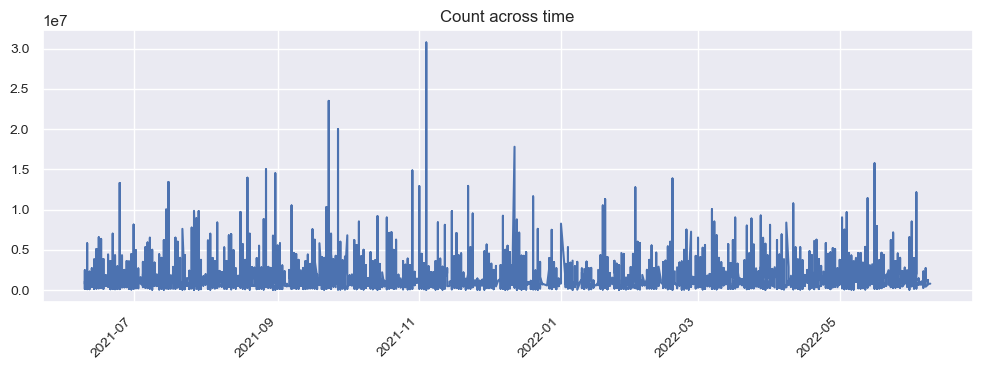

In [39]:
merged_df.plot(x='date', y='price', kind='line', rot=45, legend=None, 
        title='Count across time', xlabel='', fontsize=10, figsize=(12,4));
#plotting price of homes against date 

In [40]:
merged_df['city'].value_counts()

Seattle                    9368
Renton                     1946
Kent                       1583
Auburn                     1509
Bellevue                   1484
Kirkland                   1272
Federal Way                1168
Redmond                     985
Sammamish                   978
Maple Valley                888
Shoreline                   798
Burien                      616
Woodinville                 588
Issaquah                    564
Covington                   502
North Bend                  470
Enumclaw                    460
Des Moines                  423
Mercer Island               349
Kenmore                     347
Snoqualmie                  291
Black Diamond               279
Bothell                     264
SeaTac                      253
Duvall                      247
Lake Forest Park            218
Vashon                      194
Newcastle                   187
Tukwila                     179
Carnation                   159
Fall City                   112
Normandy

## graphing price of homes in relation to city

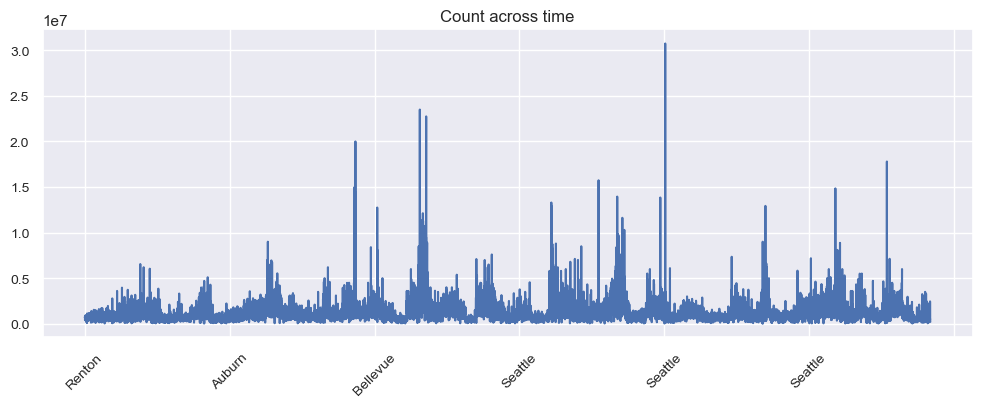

In [41]:
merged_df.plot(x='city', y='price', kind='line', rot=45, legend=None, 
        title='Count across time', xlabel='', fontsize=10, figsize=(12,4));

In [42]:
merged_df["avg area flood score"].describe()

count    29188.000000
mean         2.082427
std          0.388743
min          1.250000
25%          1.833333
50%          2.250000
75%          2.357143
max          3.000000
Name: avg area flood score, dtype: float64

In [43]:
merged_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,yr_renovated,lat,long,street address,city,zipcode,floodzones in zipcode,area flood score 1,area flood score 2,avg area flood score
0,7399300360,2022-05-24,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,0,47.461975,-122.19052,2102 Southeast 21st Court,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5
1,3340401570,2022-03-02,750000.0,3,2.0,1830,7969,1.0,NO,NO,...,2008,47.466730,-122.21400,306 South 15th Street,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5
2,7399301200,2022-03-29,728000.0,4,2.0,2170,7520,1.0,NO,NO,...,0,47.463930,-122.18974,1814 Aberdeen Avenue Southeast,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5
3,9899200050,2022-03-24,565000.0,4,2.0,1400,10364,1.5,NO,NO,...,0,47.448450,-122.21243,3426 Shattuck Avenue South,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5
4,6673070070,2021-12-28,645000.0,3,2.0,1520,8250,1.0,NO,NO,...,0,47.460870,-122.18869,2209 Southeast 21st Street,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5


In [44]:
merged_report = ProfileReport(merged_df, title = "Profiling Report")

In [45]:
merged_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## selecting homes built after 1950

In [46]:
year_selected_df = merged_df[merged_df['yr_built'] > 1950]

In [47]:
year_selected_df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,yr_renovated,lat,long,street address,city,zipcode,floodzones in zipcode,area flood score 1,area flood score 2,avg area flood score
0,7399300360,2022-05-24,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,0,47.461975,-122.190520,2102 Southeast 21st Court,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
2,7399301200,2022-03-29,728000.0,4,2.0,2170,7520,1.0,NO,NO,...,0,47.463930,-122.189740,1814 Aberdeen Avenue Southeast,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
3,9899200050,2022-03-24,565000.0,4,2.0,1400,10364,1.5,NO,NO,...,0,47.448450,-122.212430,3426 Shattuck Avenue South,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
4,6673070070,2021-12-28,645000.0,3,2.0,1520,8250,1.0,NO,NO,...,0,47.460870,-122.188690,2209 Southeast 21st Street,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
5,2781280020,2022-05-10,760600.0,3,2.5,2570,2889,2.0,NO,NO,...,0,47.450005,-122.189080,17007 114th Avenue Southeast,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29179,2024079050,2022-02-08,2451000.0,4,3.5,4050,204296,2.0,NO,NO,...,0,47.557160,-121.949320,29601 Southeast 51st Street,Preston,98050,['X'],2.000000,1.000000,1.500000
29181,7349800740,2022-01-25,500000.0,4,1.0,1410,9707,2.0,NO,NO,...,0,47.759695,-121.472345,64455 Northeast 180th Street,Baring,98251,['AE'],3.000000,3.000000,3.000000
29182,7349800710,2021-11-10,530000.0,2,2.0,1400,9600,1.5,NO,NO,...,0,47.760300,-121.473570,64421 Northeast 180th Street,Baring,98251,['AE'],3.000000,3.000000,3.000000
29183,7349700340,2021-11-04,515900.0,3,2.0,1010,10080,1.5,NO,NO,...,0,47.761500,-121.475440,64232 Northeast 182nd Street,Baring,98251,['AE'],3.000000,3.000000,3.000000


## graphing homes built after 1950 in relation to the average area flood score

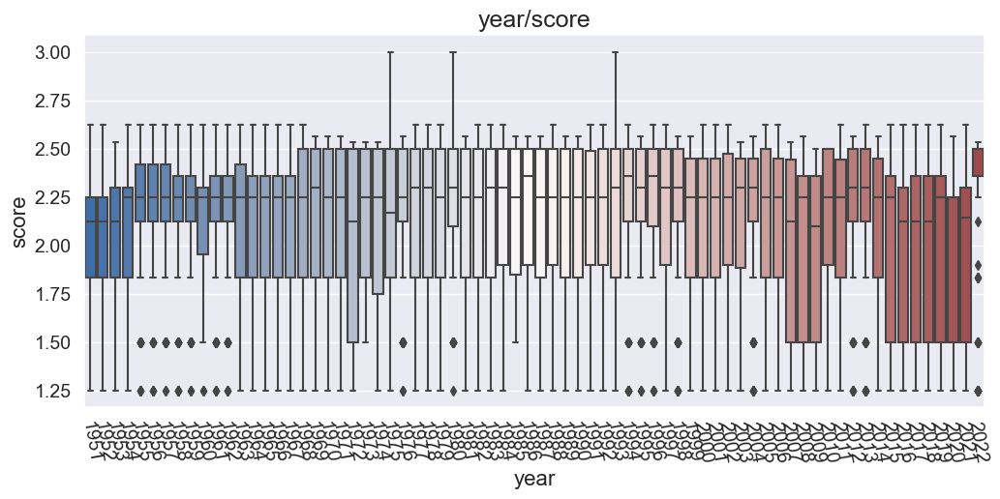

In [48]:
plt.figure(figsize=(12,5))
sns.set_style('darkgrid')
sns.boxplot(x='yr_built', y='avg area flood score', data=year_selected_df, palette='vlag')
plt.xticks(rotation=-80)
plt.ylabel('score', fontsize=16)
plt.xlabel('year', fontsize = 16)
plt.title('year/score', fontsize = 18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14);

In [49]:
year_selected_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,yr_renovated,lat,long,street address,city,zipcode,floodzones in zipcode,area flood score 1,area flood score 2,avg area flood score
0,7399300360,2022-05-24,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,0,47.461975,-122.19052,2102 Southeast 21st Court,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5
2,7399301200,2022-03-29,728000.0,4,2.0,2170,7520,1.0,NO,NO,...,0,47.463930,-122.18974,1814 Aberdeen Avenue Southeast,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5
3,9899200050,2022-03-24,565000.0,4,2.0,1400,10364,1.5,NO,NO,...,0,47.448450,-122.21243,3426 Shattuck Avenue South,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5
4,6673070070,2021-12-28,645000.0,3,2.0,1520,8250,1.0,NO,NO,...,0,47.460870,-122.18869,2209 Southeast 21st Street,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5
5,2781280020,2022-05-10,760600.0,3,2.5,2570,2889,2.0,NO,NO,...,0,47.450005,-122.18908,17007 114th Avenue Southeast,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.5


## graphing water front in relation to flood score

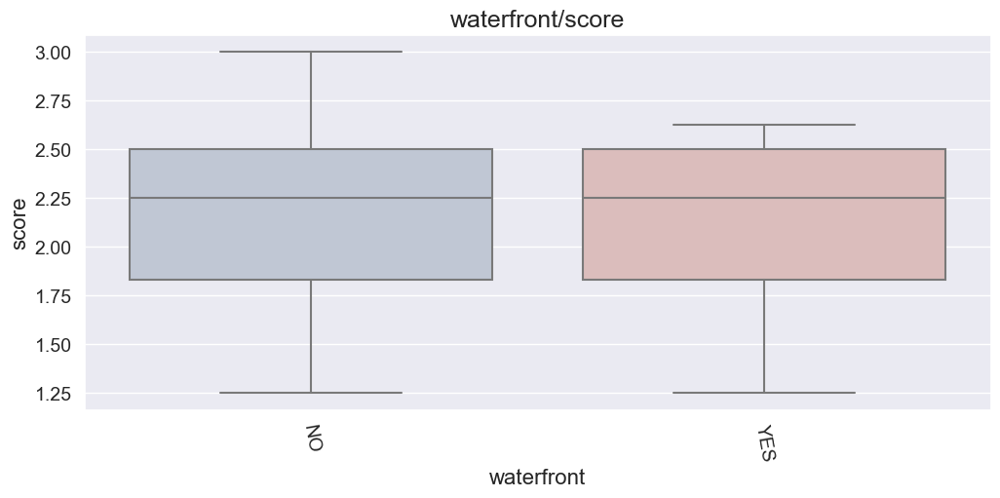

In [50]:
plt.figure(figsize=(12,5))
sns.set_style('darkgrid')
sns.boxplot(x='waterfront', y='avg area flood score', data=year_selected_df, palette='vlag')
plt.xticks(rotation=-80)
plt.ylabel('score', fontsize=16)
plt.xlabel('waterfront', fontsize = 16)
plt.title('waterfront/score', fontsize = 18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14);

Text(0.5, 1.0, 'Genre Count')

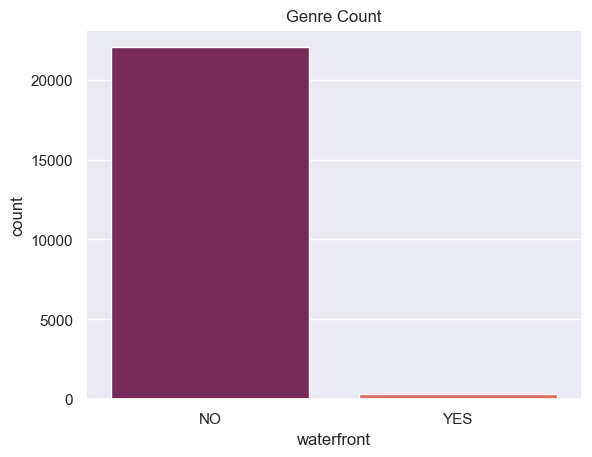

In [51]:
sns.countplot(x=year_selected_df['waterfront'], palette='rocket').set_title("Genre Count")

## ----------------------------------------------------------------------------------------------------------- Linear/Polynomial/Ridge Regression - average flood score

In [52]:
merged_df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,yr_renovated,lat,long,street address,city,zipcode,floodzones in zipcode,area flood score 1,area flood score 2,avg area flood score
0,7399300360,2022-05-24,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,0,47.461975,-122.190520,2102 Southeast 21st Court,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
1,3340401570,2022-03-02,750000.0,3,2.0,1830,7969,1.0,NO,NO,...,2008,47.466730,-122.214000,306 South 15th Street,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
2,7399301200,2022-03-29,728000.0,4,2.0,2170,7520,1.0,NO,NO,...,0,47.463930,-122.189740,1814 Aberdeen Avenue Southeast,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
3,9899200050,2022-03-24,565000.0,4,2.0,1400,10364,1.5,NO,NO,...,0,47.448450,-122.212430,3426 Shattuck Avenue South,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
4,6673070070,2021-12-28,645000.0,3,2.0,1520,8250,1.0,NO,NO,...,0,47.460870,-122.188690,2209 Southeast 21st Street,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29183,7349700340,2021-11-04,515900.0,3,2.0,1010,10080,1.5,NO,NO,...,0,47.761500,-121.475440,64232 Northeast 182nd Street,Baring,98251,['AE'],3.000000,3.000000,3.000000
29184,2943100120,2021-07-14,315000.0,1,1.0,480,7475,1.0,NO,NO,...,1970,47.736450,-121.425310,14602 681st Avenue Northeast,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333
29185,226109016,2021-11-30,250000.0,2,1.0,1040,114998,1.0,NO,NO,...,0,47.769670,-121.480570,63928 Stevens Pass Highway,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333
29186,525100215,2021-10-14,202000.0,2,1.0,1260,11160,1.5,NO,NO,...,0,47.772445,-121.483665,63608 Northeast 197th Place,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333


In [53]:
print(merged_df.dtypes)

id                                int64
date                     datetime64[ns]
price                           float64
bedrooms                          int64
bathrooms                       float64
sqft_living                       int64
sqft_lot                          int64
floors                          float64
waterfront                       object
greenbelt                        object
nuisance                         object
view                             object
condition                        object
grade                            object
heat_source                      object
sewer_system                     object
sqft_above                        int64
sqft_basement                     int64
sqft_garage                       int64
sqft_patio                        int64
yr_built                          int64
yr_renovated                      int64
lat                             float64
long                            float64
street address                   object


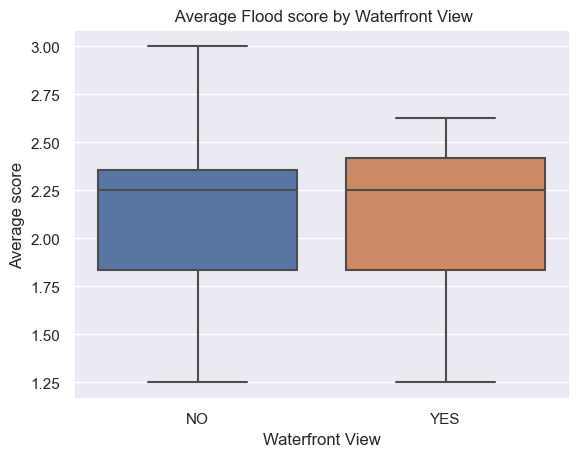

In [54]:
sns.boxplot(x='waterfront', y='avg area flood score', data=merged_df)

plt.title(' Average Flood score by Waterfront View')
plt.xlabel('Waterfront View')
plt.ylabel('Average score')

plt.show()

In [55]:
merged_df.corr()['avg area flood score'].sort_values()

/var/folders/yd/tybxdv4901xbv_l8x4p1g7tm0000gn/T/ipykernel_26938/3436310849.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  merged_df.corr()['avg area flood score'].sort_values()


lat                    -0.174184
zipcode                -0.170888
sqft_basement          -0.128796
floors                 -0.096038
price                  -0.067307
yr_renovated           -0.048387
id                     -0.045838
bathrooms               0.022034
sqft_patio              0.035403
bedrooms                0.049403
sqft_living             0.066669
sqft_lot                0.084963
sqft_above              0.117289
yr_built                0.173996
sqft_garage             0.227867
long                    0.374702
area flood score 1      0.946629
area flood score 2      0.981628
avg area flood score    1.000000
Name: avg area flood score, dtype: float64

In [56]:
X = merged_df[['avg area flood score']]
Y = merged_df['price']
lm = LinearRegression()
lm.fit(X,Y)
lm.score(X, Y)

0.004530226963021744

In [57]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

X = merged_df[['avg area flood score']]
y = merged_df['price']
model = LinearRegression()

model.fit(X, y)
r2 = r2_score(y, model.predict(X))
print('R^2:', r2)

R^2: 0.004530226963021744


In [58]:
merged_df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'greenbelt', 'nuisance', 'view',
       'condition', 'grade', 'heat_source', 'sewer_system', 'sqft_above',
       'sqft_basement', 'sqft_garage', 'sqft_patio', 'yr_built',
       'yr_renovated', 'lat', 'long', 'street address', 'city', 'zipcode',
       'floodzones in zipcode', 'area flood score 1', 'area flood score 2',
       'avg area flood score'],
      dtype='object')

In [59]:
merged_df['avg area flood score'].value_counts()

2.500000    5736
1.500000    4933
2.250000    4652
1.833333    3328
2.125000    3257
2.300000    2138
2.357143    1541
1.250000    1278
2.535714     470
1.900000     459
2.416667     364
2.450000     292
2.625000     200
2.100000     195
2.166667     180
2.562500     158
2.083333       4
3.000000       3
Name: avg area flood score, dtype: int64

In [60]:
merged_df['avg area flood score'].describe()

count    29188.000000
mean         2.082427
std          0.388743
min          1.250000
25%          1.833333
50%          2.250000
75%          2.357143
max          3.000000
Name: avg area flood score, dtype: float64

In [61]:
merged_df = merged_df.drop('heat_source', axis=1) 

In [62]:
merged_df = merged_df.drop('sewer_system', axis=1) 

In [63]:
merged_df = merged_df.drop('sqft_patio', axis=1) 

In [64]:
merged_df = merged_df.drop('sqft_basement', axis=1) 

In [65]:
merged_df = merged_df.drop('id', axis=1) 

In [66]:
merged_df = merged_df.drop('street address', axis=1) 

In [67]:
merged_df = merged_df.drop('date', axis=1) 

In [68]:
merged_df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'greenbelt', 'nuisance', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_garage', 'yr_built', 'yr_renovated', 'lat', 'long',
       'city', 'zipcode', 'floodzones in zipcode', 'area flood score 1',
       'area flood score 2', 'avg area flood score'],
      dtype='object')

In [69]:
merged_df

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,nuisance,view,...,yr_built,yr_renovated,lat,long,city,zipcode,floodzones in zipcode,area flood score 1,area flood score 2,avg area flood score
0,675000.0,4,1.0,1180,7140,1.0,NO,NO,NO,NONE,...,1969,0,47.461975,-122.190520,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
1,750000.0,3,2.0,1830,7969,1.0,NO,NO,NO,NONE,...,1950,2008,47.466730,-122.214000,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
2,728000.0,4,2.0,2170,7520,1.0,NO,NO,NO,NONE,...,1973,0,47.463930,-122.189740,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
3,565000.0,4,2.0,1400,10364,1.5,NO,NO,NO,NONE,...,1971,0,47.448450,-122.212430,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
4,645000.0,3,2.0,1520,8250,1.0,NO,NO,NO,NONE,...,1981,0,47.460870,-122.188690,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29183,515900.0,3,2.0,1010,10080,1.5,NO,NO,NO,NONE,...,1993,0,47.761500,-121.475440,Baring,98251,['AE'],3.000000,3.000000,3.000000
29184,315000.0,1,1.0,480,7475,1.0,NO,NO,YES,NONE,...,1908,1970,47.736450,-121.425310,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333
29185,250000.0,2,1.0,1040,114998,1.0,NO,NO,YES,AVERAGE,...,1928,0,47.769670,-121.480570,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333
29186,202000.0,2,1.0,1260,11160,1.5,NO,NO,YES,NONE,...,1918,0,47.772445,-121.483665,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333


In [70]:
merged_df['price'].describe().apply("{0:.5f}".format)

count       29188.00000
mean      1112991.71235
std        895790.36490
min         27360.00000
25%        645000.00000
50%        868000.00000
75%       1310000.00000
max      30750000.00000
Name: price, dtype: object

In [71]:
bins = [0, 645000, 868000, 1310000, 30750000]
labels = ['Bin 1', 'Bin 2', 'Bin 3', 'Bin 4']

merged_df['Price Bins'] = pd.cut(merged_df['price'], bins=bins, labels=labels, right=False)

In [72]:
merged_df

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,nuisance,view,...,yr_renovated,lat,long,city,zipcode,floodzones in zipcode,area flood score 1,area flood score 2,avg area flood score,Price Bins
0,675000.0,4,1.0,1180,7140,1.0,NO,NO,NO,NONE,...,0,47.461975,-122.190520,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 2
1,750000.0,3,2.0,1830,7969,1.0,NO,NO,NO,NONE,...,2008,47.466730,-122.214000,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 2
2,728000.0,4,2.0,2170,7520,1.0,NO,NO,NO,NONE,...,0,47.463930,-122.189740,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 2
3,565000.0,4,2.0,1400,10364,1.5,NO,NO,NO,NONE,...,0,47.448450,-122.212430,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 1
4,645000.0,3,2.0,1520,8250,1.0,NO,NO,NO,NONE,...,0,47.460870,-122.188690,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29183,515900.0,3,2.0,1010,10080,1.5,NO,NO,NO,NONE,...,0,47.761500,-121.475440,Baring,98251,['AE'],3.000000,3.000000,3.000000,Bin 1
29184,315000.0,1,1.0,480,7475,1.0,NO,NO,YES,NONE,...,1970,47.736450,-121.425310,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333,Bin 1
29185,250000.0,2,1.0,1040,114998,1.0,NO,NO,YES,AVERAGE,...,0,47.769670,-121.480570,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333,Bin 1
29186,202000.0,2,1.0,1260,11160,1.5,NO,NO,YES,NONE,...,0,47.772445,-121.483665,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333,Bin 1


In [73]:
merged_df['Price Bins']

0        Bin 2
1        Bin 2
2        Bin 2
3        Bin 1
4        Bin 2
         ...  
29183    Bin 1
29184    Bin 1
29185    Bin 1
29186    Bin 1
29187    Bin 1
Name: Price Bins, Length: 29188, dtype: category
Categories (4, object): ['Bin 1' < 'Bin 2' < 'Bin 3' < 'Bin 4']

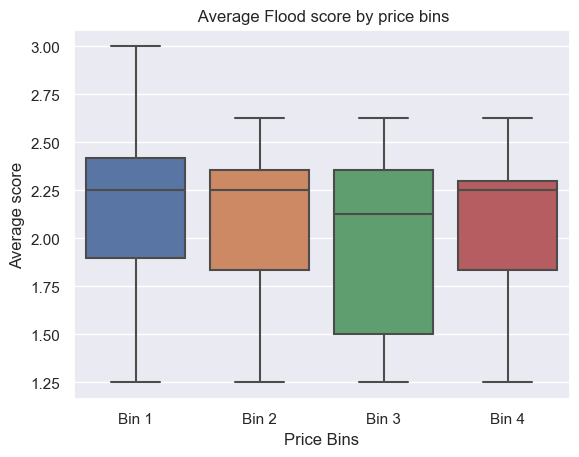

In [74]:
sns.boxplot(x='Price Bins', y='avg area flood score', data=merged_df)

plt.title(' Average Flood score by price bins')
plt.xlabel('Price Bins')
plt.ylabel('Average score')

plt.show()

## ----------------------------------------------------- Logistic regression on score

In [75]:
merged_df

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,nuisance,view,...,yr_renovated,lat,long,city,zipcode,floodzones in zipcode,area flood score 1,area flood score 2,avg area flood score,Price Bins
0,675000.0,4,1.0,1180,7140,1.0,NO,NO,NO,NONE,...,0,47.461975,-122.190520,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 2
1,750000.0,3,2.0,1830,7969,1.0,NO,NO,NO,NONE,...,2008,47.466730,-122.214000,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 2
2,728000.0,4,2.0,2170,7520,1.0,NO,NO,NO,NONE,...,0,47.463930,-122.189740,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 2
3,565000.0,4,2.0,1400,10364,1.5,NO,NO,NO,NONE,...,0,47.448450,-122.212430,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 1
4,645000.0,3,2.0,1520,8250,1.0,NO,NO,NO,NONE,...,0,47.460870,-122.188690,Renton,98055,"['X', 'AHB', 'AE']",2.666667,2.333333,2.500000,Bin 2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29183,515900.0,3,2.0,1010,10080,1.5,NO,NO,NO,NONE,...,0,47.761500,-121.475440,Baring,98251,['AE'],3.000000,3.000000,3.000000,Bin 1
29184,315000.0,1,1.0,480,7475,1.0,NO,NO,YES,NONE,...,1970,47.736450,-121.425310,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333,Bin 1
29185,250000.0,2,1.0,1040,114998,1.0,NO,NO,YES,AVERAGE,...,0,47.769670,-121.480570,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333,Bin 1
29186,202000.0,2,1.0,1260,11160,1.5,NO,NO,YES,NONE,...,0,47.772445,-121.483665,Baring,98224,"['AE', 'D', 'X', 'A', 'A06', 'C']",2.166667,2.000000,2.083333,Bin 1


In [76]:
# To start out, we'll consider y to be the target variable (Survived) and everything else to be X.
y = merged_df["avg area flood score"]
X = merged_df.drop("avg area flood score", axis=1)

In [77]:
# Specifying a random_state means that we will get consistent results even if the kernel is restarted.
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

In [78]:
X_train.isna().sum()

price                    0
bedrooms                 0
bathrooms                0
sqft_living              0
sqft_lot                 0
floors                   0
waterfront               0
greenbelt                0
nuisance                 0
view                     0
condition                0
grade                    0
sqft_above               0
sqft_garage              0
yr_built                 0
yr_renovated             0
lat                      0
long                     0
city                     0
zipcode                  0
floodzones in zipcode    0
area flood score 1       0
area flood score 2       0
Price Bins               0
dtype: int64

In [79]:
X_train_fill_na = X_train.copy()
X_train_fill_na.isna().sum()

price                    0
bedrooms                 0
bathrooms                0
sqft_living              0
sqft_lot                 0
floors                   0
waterfront               0
greenbelt                0
nuisance                 0
view                     0
condition                0
grade                    0
sqft_above               0
sqft_garage              0
yr_built                 0
yr_renovated             0
lat                      0
long                     0
city                     0
zipcode                  0
floodzones in zipcode    0
area flood score 1       0
area flood score 2       0
Price Bins               0
dtype: int64

In [80]:
X_train_fill_na.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21891 entries, 9777 to 2732
Data columns (total 24 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   price                  21891 non-null  float64 
 1   bedrooms               21891 non-null  int64   
 2   bathrooms              21891 non-null  float64 
 3   sqft_living            21891 non-null  int64   
 4   sqft_lot               21891 non-null  int64   
 5   floors                 21891 non-null  float64 
 6   waterfront             21891 non-null  object  
 7   greenbelt              21891 non-null  object  
 8   nuisance               21891 non-null  object  
 9   view                   21891 non-null  object  
 10  condition              21891 non-null  object  
 11  grade                  21891 non-null  object  
 12  sqft_above             21891 non-null  int64   
 13  sqft_garage            21891 non-null  int64   
 14  yr_built               21891 non-nul

In [81]:
X_train_categorical = X_train_fill_na.select_dtypes(exclude=["int64", "float64"]).copy()
X_train_categorical

,waterfront,greenbelt,nuisance,view,condition,grade,city,floodzones in zipcode,Price Bins
9777,NO,NO,NO,NONE,Average,8 Good,Seattle,"['X', 'C']",Bin 3
17357,NO,YES,NO,NONE,Average,9 Better,Renton,"['X', 'AE']",Bin 3
16126,NO,NO,YES,NONE,Average,9 Better,Seattle,['X'],Bin 4
1104,NO,NO,NO,NONE,Average,7 Average,Seattle,"['X', 'AE']",Bin 1
10556,NO,NO,NO,NONE,Average,7 Average,Shoreline,"['X', 'A', 'AE', 'C']",Bin 2
...,...,...,...,...,...,...,...,...,...
13123,NO,NO,YES,AVERAGE,Average,6 Low Average,Bothell,"['X', 'C', 'A06', 'AE']",Bin 3
19648,NO,NO,NO,NONE,Average,8 Good,Sammamish,"['X', 'AE']",Bin 3
9845,NO,NO,NO,NONE,Average,7 Average,Bellevue,"['X', 'AE', 'A', 'C', 'A06']",Bin 3
10799,NO,NO,NO,NONE,Good,6 Low Average,Tukwila,"['X', 'AE', 'C', 'AHB']",Bin 1


In [82]:
from sklearn.preprocessing import OneHotEncoder
import numpy as np

ohe = OneHotEncoder(handle_unknown="ignore", sparse=False)

ohe.fit(X_train_categorical)
X_train_ohe = pd.DataFrame(
    ohe.transform(X_train_categorical),
    # index is important to ensure we can concatenate with other columns
    index=X_train_categorical.index,
    # we are dummying multiple columns at once, so stack the names
    columns=np.hstack(ohe.categories_)
)
X_train_ohe

/Users/jdapeman/anaconda3/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:828: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


,NO,YES,NO,YES,NO,YES,AVERAGE,EXCELLENT,FAIR,GOOD,...,"['X', 'AO']","['X', 'C', 'A']","['X', 'C', 'A06', 'AE']","['X', 'C']","['X', 'D']",['X'],Bin 1,Bin 2,Bin 3,Bin 4
9777,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
17357,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
16126,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1104,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
10556,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13123,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
19648,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9845,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10799,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [83]:
ohe.fit(X_train_categorical)

X_train_ohe = pd.DataFrame(
    ohe.transform(X_train_categorical),
    index=X_train_categorical.index,
    columns=np.hstack(ohe.categories_)
)
X_train_ohe

/Users/jdapeman/anaconda3/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:828: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


,NO,YES,NO,YES,NO,YES,AVERAGE,EXCELLENT,FAIR,GOOD,...,"['X', 'AO']","['X', 'C', 'A']","['X', 'C', 'A06', 'AE']","['X', 'C']","['X', 'D']",['X'],Bin 1,Bin 2,Bin 3,Bin 4
9777,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
17357,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
16126,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1104,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
10556,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13123,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
19648,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9845,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10799,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [84]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29188 entries, 0 to 29187
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   price                  29188 non-null  float64 
 1   bedrooms               29188 non-null  int64   
 2   bathrooms              29188 non-null  float64 
 3   sqft_living            29188 non-null  int64   
 4   sqft_lot               29188 non-null  int64   
 5   floors                 29188 non-null  float64 
 6   waterfront             29188 non-null  object  
 7   greenbelt              29188 non-null  object  
 8   nuisance               29188 non-null  object  
 9   view                   29188 non-null  object  
 10  condition              29188 non-null  object  
 11  grade                  29188 non-null  object  
 12  sqft_above             29188 non-null  int64   
 13  sqft_garage            29188 non-null  int64   
 14  yr_built               29188 non-null 

In [85]:
numeric_features = ["price", "bedrooms", "bathrooms", "sqft_living","sqft_lot","floors","sqft_above","sqft_garage"
                   ,"yr_built","yr_renovated","lat","long","zipcode"]
X_train_numeric = X_train_fill_na[numeric_features].copy()
X_train_numeric

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_garage,yr_built,yr_renovated,lat,long,zipcode
9777,1058000.0,3,2.5,1480,1567,2.0,1120,220,2013,0,47.674460,-122.376890,98107
17357,1250000.0,4,3.5,4360,6939,2.0,3310,510,1998,0,47.511075,-122.174395,98056
16126,1625000.0,2,2.0,1260,6000,1.0,630,220,1965,0,47.640440,-122.307510,98112
1104,547000.0,3,1.0,1490,9075,1.0,1490,0,1955,0,47.496310,-122.235370,98178
10556,775000.0,2,1.0,1340,9105,1.0,860,440,1978,0,47.756255,-122.326980,98155
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13123,1210000.0,3,2.0,1640,53578,1.5,1640,0,1947,2018,47.748895,-122.175508,98011
19648,1130000.0,3,2.5,1690,5631,2.0,1690,440,1989,0,47.574860,-122.009440,98029
9845,1200000.0,6,2.0,2200,9004,1.0,1360,380,1957,0,47.605105,-122.126875,98008
10799,510000.0,2,2.0,1257,8100,1.0,1257,210,1945,0,47.479810,-122.282220,98168


In [86]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

scaler.fit(X_train_numeric)
X_train_scaled = pd.DataFrame(
    scaler.transform(X_train_numeric),
    # index is important to ensure we can concatenate with other columns
    index=X_train_numeric.index,
    columns=X_train_numeric.columns
)
X_train_scaled

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_garage,yr_built,yr_renovated,lat,long,zipcode
9777,0.045357,0.230769,0.238095,0.096178,0.000380,0.333333,0.088324,0.061453,0.926230,0.000000,0.818190,0.109900,0.369338
17357,0.053807,0.307692,0.333333,0.283714,0.002131,0.333333,0.261337,0.142458,0.803279,0.000000,0.560715,0.258500,0.191638
16126,0.070310,0.153846,0.190476,0.081852,0.001825,0.000000,0.049613,0.061453,0.532787,0.000000,0.764579,0.160814,0.386760
1104,0.022869,0.230769,0.095238,0.096829,0.002828,0.000000,0.117554,0.000000,0.450820,0.000000,0.537447,0.213754,0.616725
10556,0.032903,0.153846,0.095238,0.087061,0.002838,0.000000,0.067783,0.122905,0.639344,0.000000,0.947090,0.146526,0.536585
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13123,0.052047,0.230769,0.190476,0.106596,0.017338,0.166667,0.129404,0.000000,0.385246,0.998022,0.935491,0.257683,0.034843
19648,0.048526,0.230769,0.238095,0.109852,0.001705,0.333333,0.133354,0.122905,0.729508,0.000000,0.661232,0.379551,0.097561
9845,0.051607,0.461538,0.190476,0.143062,0.002805,0.000000,0.107284,0.106145,0.467213,0.000000,0.708895,0.293372,0.024390
10799,0.021240,0.153846,0.190476,0.081657,0.002510,0.000000,0.099147,0.058659,0.368852,0.000000,0.511445,0.179373,0.581882


In [87]:
X_train_full = pd.concat([X_train_scaled, X_train_ohe], axis=1)
X_train_full

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_garage,yr_built,yr_renovated,...,"['X', 'AO']","['X', 'C', 'A']","['X', 'C', 'A06', 'AE']","['X', 'C']","['X', 'D']",['X'],Bin 1,Bin 2,Bin 3,Bin 4
9777,0.045357,0.230769,0.238095,0.096178,0.000380,0.333333,0.088324,0.061453,0.926230,0.000000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
17357,0.053807,0.307692,0.333333,0.283714,0.002131,0.333333,0.261337,0.142458,0.803279,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
16126,0.070310,0.153846,0.190476,0.081852,0.001825,0.000000,0.049613,0.061453,0.532787,0.000000,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1104,0.022869,0.230769,0.095238,0.096829,0.002828,0.000000,0.117554,0.000000,0.450820,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
10556,0.032903,0.153846,0.095238,0.087061,0.002838,0.000000,0.067783,0.122905,0.639344,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13123,0.052047,0.230769,0.190476,0.106596,0.017338,0.166667,0.129404,0.000000,0.385246,0.998022,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
19648,0.048526,0.230769,0.238095,0.109852,0.001705,0.333333,0.133354,0.122905,0.729508,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9845,0.051607,0.461538,0.190476,0.143062,0.002805,0.000000,0.107284,0.106145,0.467213,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10799,0.021240,0.153846,0.190476,0.081657,0.002510,0.000000,0.099147,0.058659,0.368852,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [88]:
from sklearn.linear_model import LogisticRegression

logreg = LogisticRegression(fit_intercept=False, C=1e12, solver='liblinear')
model_log = logreg.fit(X_train_full, y_train)
model_log

ValueError: Unknown label type: 'continuous'

In [ ]:
y_hat_train = logreg.predict(X_train_full)

train_residuals = np.abs(y_train - y_hat_train)
print(pd.Series(train_residuals, name="Residuals (counts)").value_counts())
print()
print(pd.Series(train_residuals, name="Residuals (proportions)").value_counts(normalize=True))

In [ ]:
merged_df.corr()

In [ ]:
merged_df.corr()

In [ ]:
def change_to_datetime(df):
    ''' Changes date to DateTime object'''
    df['date'] = pd.to_datetime(df['date'])
    return df

In [ ]:
new_df['sqft_basement'].describe()

In [ ]:
merged_df['grade'][0]

In [ ]:
df2 = pd.read_csv("/Users/jdapeman/Documents/Flatiron/Kings_C_PROJECT/cleaned_training_2.csv")


In [ ]:
df2

In [ ]:
df2.info()

In [ ]:
## import pandas as pd
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt

# Assuming df2 is a valid DataFrame

# Define the predictor variables (x1, x2) and the response variable (y)
columns_to_drop = ['avg_area_flood_score', 'date', 'heat_source', 'sewer_system', 'street address', 'city', 'floodzones_in_zipcode']
X = df2.drop(columns=columns_to_drop)
y = df2['avg_area_flood_score']

# Add a constant column to the predictor variables matrix
X = sm.add_constant(X)

# Fit the regression model
model = sm.OLS(y, X)
results = model.fit()

# Plot the data points
plt.scatter(df2['price'], y, label='x1')
plt.scatter(df2['avg_area_flood_score'], y, label='x2')

# Generate predicted values from the regression model
y_pred = results.predict(X)

# Plot the regression line
plt.plot(df2['avg_area_flood_score'], y_pred, label='Regression Line')

# Add labels and legend
plt.xlabel('x')
plt.ylabel('y')
plt.legend()

# Show the plot
plt.show()

In [ ]:
sns.regplot(x="price", y='avg_area_flood_score', data=df2);

In [ ]:
import statsmodels.formula.api as smf

rstyle_model = smf.ols(formula="price ~ avg_area_flood_score", data=df2)
rstyle_results = rstyle_model.fit()
print(rstyle_results.summary())

In [ ]:
rstyle_model = smf.ols(formula="df2['price'] ~ df2['condition score']", data=df2)
rstyle_results = rstyle_model.fit()
print(rstyle_results.summary())

In [ ]:
rstyle_model = smf.ols(formula="df2['price'] ~ df2['grade score']", data=df2)
rstyle_results = rstyle_model.fit()
print(rstyle_results.summary())

In [ ]:
rstyle_model = smf.ols(formula="df2['avg_area_flood_score'] ~ df2['grade score']", data=df2)
rstyle_results = rstyle_model.fit()
print(rstyle_results.summary())

In [ ]:
df2.hist(figsize = (15,12))
plt.show()

In [ ]:
df2.corr()

In [ ]:
df2_rp = ProfileReport(df2, title = "Profiling Report")

In [ ]:
df2_rp

In [ ]:
df2.columns

In [ ]:
df2 = df2.drop('Unnamed: 0', axis=1) 

In [ ]:
df2 = df2.drop('id', axis=1) 

In [ ]:
df2 = df2.drop('date', axis=1) 

In [ ]:
mean_value = df2['sqft_garage'].mean()
df2['sqft_garage'] = df2['sqft_garage'].replace(0, mean_value)

In [ ]:
mean_value2 = df2['sqft_patio'].mean()
df2['sqft_patio'] = df2['sqft_patio'].replace(0, mean_value2)

In [ ]:
df2 = df2.drop('yr_renovated', axis=1) 

In [ ]:
df2

In [ ]:
df3_rp = ProfileReport(df2, title = "Profiling Report")

In [ ]:
df3_rp

In [ ]:
df2.corr()

In [ ]:
df3 = df2

In [ ]:
df3 = df3.drop('heat_source', axis=1) 

In [ ]:
df3 = df3.drop('sewer_system', axis=1) 

In [ ]:
df3 = df3.drop('city', axis=1) 

In [ ]:
df3 = df3.drop('floodzones_in_zipcode', axis=1) 

In [ ]:
plt.figure(figsize=(12, 6))  # Adjust the figure size as per your preference
df3.boxplot(column=list(df3.columns), showfliers=True)

# Add title and labels
plt.title('Box Plot with Outliers')
plt.xlabel('Columns')
plt.ylabel('Values')

# Rotate x-axis labels if needed
plt.xticks(rotation=90)

# Show the plot
plt.show()

In [ ]:
df2[["price"]].describe().applymap(lambda x: f"{x:0.3f}")

In [ ]:
df2 = df2[df2['price'] < 1225000.000]

In [ ]:
df2[["price"]].describe().applymap(lambda x: f"{x:0.3f}")

In [ ]:
df2 = df2[df2['price'] > 629950.000]

In [ ]:
df2[["price"]].describe().applymap(lambda x: f"{x:0.3f}")

In [ ]:
df2.info()

In [ ]:
sns.pairplot(df2)
plt.show()

In [ ]:
plt.figure(figsize=(18,16))
sns.heatmap(df2.corr().abs(), annot=True)
plt.show()

In [ ]:
X = df2[['price']]
y = df2['on_waterfront']

simple_model = sm.OLS(endog=y, exog=sm.add_constant(X)).fit()

In [ ]:
lr = LinearRegression()
lr.fit(X,y)
lr.score(X,y)
pd.DataFrame(zip(X.columns,lr.coef_))

In [ ]:
simple_model_summary = simple_model.summary()
simple_model_summary

In [ ]:
sns.regplot(x="price", y="avg_area_flood_score", data=df2);

In [ ]:
sns.lmplot(x="avg_area_flood_score", y="price", data=df2, x_estimator=np.mean);

In [ ]:
df2.info()

In [ ]:
df2 = df2[df2['sqft_lot'] < 9601]

In [ ]:
df2['sqft_patio'].describe()

In [ ]:
df2 = df2[df2['sqft_patio'] > 11]

In [ ]:
df2 = df2[df2['sqft_patio'] < 185]

In [ ]:
df2['sqft_garage'].describe()

In [ ]:
df2 = df2[df2['sqft_garage'] > 316]

In [ ]:
df2 = df2[df2['sqft_garage'] < 441]

In [ ]:
cont_feat = ['sqft_living', 'sqft_lot', 'sqft_patio', 'avg_area_flood_score', 'sqft_garage', 'lat', 'long']


#  Plot jointplots
for feature in cont_feat:
    sns.jointplot(x = df2[feature], y = df2['price'], kind = 'reg')

In [ ]:
df2['sqft_lot'].describe()

In [ ]:
corr = df2.corr()

# Plot heatmap
plt.figure(figsize = (15,10))
sns.heatmap(corr, center = 0, annot = True, cmap = 'coolwarm')
plt.title('Correlation Heatmap')
plt.show()

In [ ]:
X_train = np.array(df2['avg_area_flood_score']).reshape(-1,1)
y_train = df2['price']

In [ ]:
X_int = sm.add_constant(X_train)
model = sm.OLS(y_train, X_int).fit()
summary = model.summary()
summary

In [ ]:
linreg = LinearRegression()

# Fit on training data
linreg.fit(X_train, y_train)

# Evaluate using rmse
scores = cross_val_score(
            linreg, 
            X_train,
            y_train,
            cv=10,
            scoring="neg_mean_squared_error"
)

rmse_scores = np.sqrt(-scores)
display(rmse_scores)
display(rmse_scores.mean())
display(rmse_scores.std())

In [ ]:
y_pred = linreg.predict(X_train)
# Plot data points
plt.scatter(x = X_train[:2000], y = y_train[:2000], alpha = 0.3, label = 'Data Points')
# Plot regression line
plt.plot(X_train, y_pred, color = 'red', label = 'Regression Line')
plt.legend()
plt.title('Simple linear regression' )
plt.xlabel('score')
plt.ylabel('Price (USD)')
plt.show()

In [ ]:
evaluationtable = pd.DataFrame({'Model': [], 'Description':[], ' Num Features' : [], 'R-squared':[],
                                'Adj R-squared':[], 'RMSE': [],'RMSE sd':[]})

# Add data for simple linear regression
evaluationtable.loc[0] = ['Simple Linear Regression', 'score', model.df_model, round(model.rsquared,3)
                          ,round(model.rsquared_adj,3), int(rmse_scores.mean()), int(rmse_scores.std()) ]

# View our evaluation table
evaluationtable

In [ ]:
df2.info()

In [ ]:
def neighborhood_feat(df):
   
    
    # Define coord column with lat and long
    df['coord'] = list(zip(df['lat'], df['long']))
    
    # Use reverse geocoder
    results = rg.search(list(df['coord']))
    
    # Define neighbourhood list
    neighborhoods = [results[i]['name'] for i in range(0, len(results))]
    
    # Add neighbourhood feature
    df['neighborhood'] = neighborhoods
    
    return df

In [ ]:
df3 = onehot_df_2.copy()

In [ ]:
df23 = neighborhood_feat(df2)

In [ ]:
X_train = df3[]

In [ ]:
X_int = sm.add_constant(X_train)
model = sm.OLS(y_train, X_int).fit()
summary = model.summary()
summary

In [ ]:
from itertools import combinations
from statsmodels.formula.api import ols
import statsmodels.api as sm
import scipy.stats as stats
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import r2_score, mean_squared_error
import warnings
warnings.filterwarnings('ignore')

In [96]:
## test data

test_df = pd.read_csv('/Users/jdapeman/Documents/Flatiron/Kings_C_PROJECT/test_cleaned.csv')

In [97]:
test_df

,id,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,sqft_garage,...,area flood score 2,avg area flood score,price,grade score,has_basement,on_waterfront,near_greenbelt,view score,nuisance,condition score
0,4322300140,2022-01-17,3,2.5,1979,13439,1.0,1180,1079,280,...,1.000000,1.500000,600000.0,7,1,0,0,0,0,5
1,3928000040,2021-11-03,4,3.0,2450,8772,2.0,2450,0,460,...,1.800000,1.900000,698507.0,8,0,0,0,0,0,3
2,3359500340,2021-09-20,3,1.0,1100,3000,1.0,1100,0,0,...,1.666667,1.833333,686500.0,6,0,0,0,0,1,3
3,3629200040,2022-03-30,4,3.0,3800,10194,1.0,3060,1320,580,...,1.000000,1.500000,2720000.0,9,1,0,0,0,0,3
4,5469501620,2022-05-19,4,3.5,3840,15347,1.0,1920,1920,580,...,2.333333,2.500000,900000.0,9,1,0,0,2,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8664,7712600105,2022-03-30,3,2.0,2050,6250,1.0,1450,1480,330,...,1.666667,1.833333,1450000.0,8,1,0,0,2,1,4
8665,567000321,2022-02-24,3,3.5,2150,1342,3.0,1580,570,380,...,1.000000,1.500000,1460000.0,9,1,0,0,0,0,3
8666,6453430610,2021-09-10,4,2.5,2560,4116,2.0,2560,0,510,...,2.285714,2.357143,892589.0,8,0,0,0,0,0,3
8667,192480270,2022-04-12,4,2.5,2560,4547,2.0,2560,0,410,...,2.333333,2.500000,748950.0,8,0,0,0,0,0,3


In [100]:
test_df.columns

Index(['id', 'date', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'sqft_above', 'sqft_basement', 'sqft_garage', 'sqft_patio',
       'yr_built', 'yr_renovated', 'lat', 'long', 'street address', 'city',
       'zipcode', 'floodzones in zipcode', 'area flood score 1',
       'area flood score 2', 'avg area flood score', 'price', 'grade score',
       'has_basement', 'on_waterfront', 'near_greenbelt', 'view score',
       'nuisance', 'condition score'],
      dtype='object')

In [98]:
#t-test: This test is used to compare the means of two groups to determine if they are significantly different.

group1 = test_df['price']
group2 = test_df['avg area flood score']

t_statistic, p_value = stats.ttest_ind(group1, group2)
print("T-Statistic:", t_statistic)
print("P-Value:", p_value)



T-Statistic: 155.11207475890242
P-Value: 0.0


In [99]:
#Chi-square test: This test is used to determine if there is a significant association between 
#two categorical variables.

observed = [test_df['price'], test_df['avg area flood score']]

chi2_statistic, p_value, dof, expected = stats.chi2_contingency(observed)
print("Chi-square Statistic:", chi2_statistic)
print("P-Value:", p_value)


Chi-square Statistic: 7922.539487614782
P-Value: 0.9999999971887022


In [101]:
#ANOVA: This test is used to compare the means of more than two
#groups to determine if there is a significant difference among them.

group1 = test_df['price']
group2 = test_df['avg area flood score']
group3 = test_df['grade score']

f_statistic, p_value = stats.f_oneway(group1, group2, group3)
print("F-Statistic:", f_statistic)
print("P-Value:", p_value)


F-Statistic: 24059.630015154133
P-Value: 0.0


In [105]:


# Add a constant column for the intercept
df = sm.add_constant(test_df['avg area flood score'])

# Perform linear regression
model = sm.OLS(test_df['price'], test_df[['avg area flood score', 'price']])
results = model.fit()

# Print the regression summary
print(results.summary())

                                 OLS Regression Results                                
Dep. Variable:                  price   R-squared (uncentered):                   1.000
Model:                            OLS   Adj. R-squared (uncentered):              1.000
Method:                 Least Squares   F-statistic:                          3.736e+34
Date:                Thu, 01 Jun 2023   Prob (F-statistic):                        0.00
Time:                        09:29:48   Log-Likelihood:                      1.7487e+05
No. Observations:                8669   AIC:                                 -3.497e+05
Df Residuals:                    8667   BIC:                                 -3.497e+05
Df Model:                           2                                                  
Covariance Type:            nonrobust                                                  
                           coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------